In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/ANPR

Mounted at /content/drive
/content/drive/MyDrive/ANPR


In [ ]:
!pip install ultralytics
!pip install easyocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 779.6/779.6 kB 9.3 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-m

In [ ]:
import cv2 as cv
from glob import glob
import os
import random
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt
import numpy as np
import ast
import cv2 as cv
import easyocr
from glob import glob
import numpy as np
import pandas as pd
from google.colab.patches import cv2_imshow
import string
from ultralytics import YOLO

In [ ]:
# dataset = '/content/drive/MyDrive/ANPR/data.yaml'

# backbone = YOLO("yolov8n.pt")

In [ ]:
# results = backbone.train(data=dataset, epochs=20)  # train the model

In [ ]:
# # Export the model to ONNX format
# # success = model.export(imgsz=(640, 480), format='onnx', opset=12, optimize=False, half=False)
# # Export to PyTorch format
# success = backbone.export(imgsz=640, format='torchscript', optimize=False, half=False, int8=False)
# # TorchScript: export success ✅ 1.5s, saved as 'runs/detect/train11/weights/best.torchscript' (11.9 MB)

In [ ]:
# regular pre-trained yolov8 model for car recognition
# coco_model = YOLO('yolov8n.pt')
coco_model = YOLO('yolov8s.pt')
# yolov8 model trained to detect number plates
np_model = YOLO('/content/drive/MyDrive/ANPR/license_plate_detector.pt')

In [ ]:
# read in test video paths
videos = glob('/content/drive/MyDrive/ANPR/T/vid.mp4')
print(videos)

['/content/drive/MyDrive/ANPR/T/vid.mp4']


In [ ]:
# # read video by index
# video = cv.VideoCapture(videos[0])

# ret = True
# frame_number = -1
# # all vehicle class IDs from the COCO dataset (car, motorbike, truck) https://docs.ultralytics.com/datasets/detect/coco/#dataset-yaml
# vehicles = [2,3,5]
# vehicle_bounding_boxes = []

# # get video dims
# frame_width = int(video.get(cv.CAP_PROP_FRAME_WIDTH))
# frame_height = int(video.get(cv.CAP_PROP_FRAME_HEIGHT))
# size = (frame_width, frame_height)

# # read the 10 first frames
# while ret:
#     frame_number += 1
#     ret, frame = video.read()

#     if ret and frame_number < 10:
#         # use track() to identify instances and track them frame by frame
#         frame = cv.resize(frame, (frame_width, frame_height))
#         detections = coco_model.track(frame, persist=True)[0]
#         # save cropped detections
#         # detections.save_crop('outputs')
#         # print nodel predictions for debugging
#         # print(results)

#         for detection in detections.boxes.data.tolist():
#             # print detection bounding boxes for debugging
#             # print(detection)
#             x1, y1, x2, y2, track_id, score, class_id = detection
#             # I am only interested in class IDs that belong to vehicles
#             if int(class_id) in vehicles and score > 0.5:
#                 vehicle_bounding_boxes.append([x1, y1, x2, y2, track_id, score])

# # print found bounding boxes for debugging
# print(vehicle_bounding_boxes)
# video.release()

In [ ]:
# read video by index
video = cv.VideoCapture(videos[0])

ret = True
frame_number = -1
vehicles = [2,3,5]

# get video dims
frame_width = int(video.get(cv.CAP_PROP_FRAME_WIDTH))
frame_height = int(video.get(cv.CAP_PROP_FRAME_HEIGHT))
size = (frame_width, frame_height)

# read the 10 first frames
while ret:
    frame_number += 1
    ret, frame = video.read()

    if ret and frame_number < 10:

        # vehicle detector
        frame = cv.resize(frame, (frame_width, frame_height))
        detections = coco_model.track(frame, persist=True)[0]

        for detection in detections.boxes.data.tolist():
            x1, y1, x2, y2, track_id, score, class_id = detection
            if int(class_id) in vehicles and score > 0.5:
                vehicle_bounding_boxes = []
                vehicle_bounding_boxes.append([x1, y1, x2, y2, track_id, score])
                for bbox in vehicle_bounding_boxes:
                    print(bbox)
                    roi = frame[int(y1):int(y2), int(x1):int(x2)]
                    # debugging check if bbox lines up with detected vehicles (should be identical to save_crops() above
                    # cv.imwrite(str(track_id) + '.jpg', roi)

                    # license plate detector for region of interest
                    license_plates = np_model(roi)[0]
                    # check every bounding box for a license plate
                    for license_plate in license_plates.boxes.data.tolist():
                        plate_x1, plate_y1, plate_x2, plate_y2, plate_score, _ = license_plate
                        # verify detections
                        print(license_plate, 'track_id: ' + str(bbox[4]))
                        plate = roi[int(plate_y1):int(plate_y2), int(plate_x1):int(plate_x2)]
                        cv.imwrite(str(track_id) + '.jpg', plate)

video.release()

requirements: Ultralytics requirement ['lapx>=0.5.2'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 42.9 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 6.6s, installed 1 package: ['lapx>=0.5.2']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


0: 384x640 11 cars, 2 trucks, 558.1ms
Speed: 9.9ms preprocess, 558.1ms inference, 30.0ms postprocess per image at shape (1, 3, 384, 640)
[2171.88232421875, 1154.3953857421875, 2826.26025390625, 1738.1531982421875, 1.0, 0.8925710916519165]

0: 576x640 1 license_plate, 335.9ms
Speed: 4.4ms preprocess, 335.9ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)
[245.61875915527344, 411.789794921875, 414.0835876464844, 477.625, 0.7336516380310059, 0.0] track_id: 1.0
[751.021728515625, 1370.9886474609375, 1453.247314453125, 1985.9527587890625, 2.0, 0.886263370513916]

0: 576x640 1 license_plate, 319.4ms
Speed: 4.3ms preprocess, 319.4ms inference, 1.4ms post

In [ ]:
# read video by index
video = cv.VideoCapture(videos[0])

ret = True
frame_number = -1
vehicles = [2,3,5]

# read the 10 first frames
while ret:
    frame_number += 1
    ret, frame = video.read()

    if ret and frame_number < 100:

        # vehicle detector
        frame = cv.resize(frame, (frame_width, frame_height))
        detections = coco_model.track(frame, persist=True)[0]
        for detection in detections.boxes.data.tolist():
            x1, y1, x2, y2, track_id, score, class_id = detection
            if int(class_id) in vehicles and score > 0.5:
                vehicle_bounding_boxes = []
                vehicle_bounding_boxes.append([x1, y1, x2, y2, track_id, score])
                for bbox in vehicle_bounding_boxes:
                    print(bbox)
                    roi = frame[int(y1):int(y2), int(x1):int(x2)]

                    # license plate detector for region of interest
                    license_plates = np_model(roi)[0]
                    # process license plate
                    for license_plate in license_plates.boxes.data.tolist():
                        print("Im in")
                        plate_x1, plate_y1, plate_x2, plate_y2, plate_score, _ = license_plate
                        # crop plate from region of interest
                        plate = roi[int(plate_y1):int(plate_y2), int(plate_x1):int(plate_x2)]
                        # de-colorize
                        plate_gray = cv.cvtColor(plate, cv.COLOR_BGR2GRAY)
                        # posterize
                        _, plate_treshold = cv.threshold(plate_gray, 64, 255, cv.THRESH_BINARY_INV)
                        cv.imwrite(str(track_id) + '_gray.jpg', plate_gray)
                        cv.imwrite(str(track_id) + '_thresh.jpg', plate_treshold)
                        print("out")

video.release()

Streaming output truncated to the last 5000 lines.
out
[1460.6180419921875, 790.9149780273438, 1793.7852783203125, 1113.0587158203125, 11.0, 0.6455543041229248]

0: 640x640 1 license_plate, 219.1ms
Speed: 3.9ms preprocess, 219.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Im in
out
[1276.3155517578125, 866.6029663085938, 1670.238037109375, 1118.5853271484375, 12.0, 0.8613382577896118]

0: 416x640 (no detections), 146.3ms
Speed: 7.0ms preprocess, 146.3ms inference, 0.5ms postprocess per image at shape (1, 3, 416, 640)
[2219.246337890625, 830.238037109375, 2577.767822265625, 1111.2679443359375, 13.0, 0.7208979725837708]

0: 512x640 (no detections), 192.8ms
Speed: 4.0ms preprocess, 192.8ms inference, 0.5ms postprocess per image at shape (1, 3, 512, 640)
[2317.073486328125, 1844.23828125, 3418.896484375, 2151.712646484375, 14.0, 0.7119268178939819]

0: 192x640 (no detections), 74.5ms
Speed: 2.1ms preprocess, 74.5ms inference, 0.5ms postprocess per image at shape (1, 

In [ ]:
# Initialize the OCR reader
reader = easyocr.Reader(['en'], gpu=True)
def read_license_plate(license_plate_crop):
    detections = reader.readtext(license_plate_crop)

    for detection in detections:
        bbox, text, score = detection

        text = text.upper().replace(' ', '')

        return text, score

    return None, None

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [ ]:
def write_csv(results, output_path):

    with open(output_path, 'w') as f:
        f.write('{},{},{},{},{},{},{},{}\n'.format(
            'frame_number', 'track_id', 'car_bbox', 'car_bbox_score',
            'license_plate_bbox', 'license_plate_bbox_score', 'license_plate_number',
            'license_text_score'))

        for frame_number in results.keys():
            for track_id in results[frame_number].keys():
                print(results[frame_number][track_id])
                if 'car' in results[frame_number][track_id].keys() and \
                   'license_plate' in results[frame_number][track_id].keys() and \
                   'number' in results[frame_number][track_id]['license_plate'].keys():
                    f.write('{},{},{},{},{},{},{},{}\n'.format(
                        frame_number,
                        track_id,
                        '[{} {} {} {}]'.format(
                            results[frame_number][track_id]['car']['bbox'][0],
                            results[frame_number][track_id]['car']['bbox'][1],
                            results[frame_number][track_id]['car']['bbox'][2],
                            results[frame_number][track_id]['car']['bbox'][3]
                        ),
                        results[frame_number][track_id]['car']['bbox_score'],
                        '[{} {} {} {}]'.format(
                            results[frame_number][track_id]['license_plate']['bbox'][0],
                            results[frame_number][track_id]['license_plate']['bbox'][1],
                            results[frame_number][track_id]['license_plate']['bbox'][2],
                            results[frame_number][track_id]['license_plate']['bbox'][3]
                        ),
                        results[frame_number][track_id]['license_plate']['bbox_score'],
                        results[frame_number][track_id]['license_plate']['number'],
                        results[frame_number][track_id]['license_plate']['text_score'])
                    )
        f.close()

In [ ]:
results = {}

# read video by index
video = cv.VideoCapture(videos[0])

ret = True
frame_number = -1
vehicles = [2,3,5]

# read the 10 first frames
while ret:
    frame_number += 1
    ret, frame = video.read()

    if ret and frame_number < 100:
        results[frame_number] = {}

        # vehicle detector
        frame = cv.resize(frame, (frame_width, frame_height))
        detections = coco_model.track(frame, persist=True)[0]
        for detection in detections.boxes.data.tolist():
            x1, y1, x2, y2, track_id, score, class_id = detection
            if int(class_id) in vehicles and score > 0.5:
                vehicle_bounding_boxes = []
                vehicle_bounding_boxes.append([x1, y1, x2, y2, track_id, score])
                for bbox in vehicle_bounding_boxes:
                    print(bbox)
                    roi = frame[int(y1):int(y2), int(x1):int(x2)]

                    # license plate detector for region of interest
                    license_plates = np_model(roi)[0]
                    # process license plate
                    for license_plate in license_plates.boxes.data.tolist():
                        plate_x1, plate_y1, plate_x2, plate_y2, plate_score, _ = license_plate
                        # crop plate from region of interest
                        plate = roi[int(plate_y1):int(plate_y2), int(plate_x1):int(plate_x2)]
                        # de-colorize
                        plate_gray = cv.cvtColor(plate, cv.COLOR_BGR2GRAY)
                        # posterize
                        _, plate_treshold = cv.threshold(plate_gray, 64, 255, cv.THRESH_BINARY_INV)

                        # OCR
                        np_text, np_score = read_license_plate(plate_treshold)
                        # if plate could be read write results
                        if np_text is not None:
                            results[frame_number][track_id] = {
                                'car': {
                                    'bbox': [x1, y1, x2, y2],
                                    'bbox_score': score
                                },
                                'license_plate': {
                                    'bbox': [plate_x1, plate_y1, plate_x2, plate_y2],
                                    'bbox_score': plate_score,
                                    'number': np_text,
                                    'text_score': np_score
                                }
                            }

write_csv(results, './results.csv')
video.release()


0: 384x640 9 cars, 3 trucks, 887.7ms
Speed: 4.0ms preprocess, 887.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)
[819.5261840820312, 1382.6881103515625, 1529.955078125, 1977.5628662109375, 6.0, 0.886263370513916]

0: 544x640 1 license_plate, 317.6ms
Speed: 3.6ms preprocess, 317.6ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)
[742.6336669921875, 561.92529296875, 892.772216796875, 742.8651123046875, 9.0, 0.5904224514961243]

0: 640x544 (no detections), 399.9ms
Speed: 3.3ms preprocess, 399.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 544)
[1304.6446533203125, 861.1227416992188, 1698.538818359375, 1156.112060546875, 11.0, 0.6605443358421326]

0: 480x640 (no detections), 343.8ms
Speed: 4.3ms preprocess, 343.8ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)
[1208.08544921875, 1014.5479125976562, 1719.8529052734375, 1421.50146484375, 12.0, 0.8145961165428162]

0: 512x640 (no detections), 520.4ms
Speed: 4.3ms pre

In [ ]:
# Mapping dictionaries for character conversion
# characters that can easily be confused can be
# verified by their location - an `O` in a place
# where a number is expected is probably a `0`
dict_char_to_int = {'O': '0',
                    'I': '1',
                    'J': '3',
                    'A': '4',
                    'G': '6',
                    'S': '5'}

dict_int_to_char = {'0': 'O',
                    '1': 'I',
                    '3': 'J',
                    '4': 'A',
                    '6': 'G',
                    '5': 'S'}

In [ ]:
def license_complies_format(text):
    # True if the license plate complies with the format, False otherwise.
    if len(text) != 7:
        return False

    if (text[0] in string.ascii_uppercase or text[0] in dict_int_to_char.keys()) and \
       (text[1] in string.ascii_uppercase or text[1] in dict_int_to_char.keys()) and \
       (text[2] in ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'] or text[2] in dict_char_to_int.keys()) and \
       (text[3] in ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'] or text[3] in dict_char_to_int.keys()) and \
       (text[4] in string.ascii_uppercase or text[4] in dict_int_to_char.keys()) and \
       (text[5] in string.ascii_uppercase or text[5] in dict_int_to_char.keys()) and \
       (text[6] in string.ascii_uppercase or text[6] in dict_int_to_char.keys()):
        return True
    else:
        return False

def format_license(text):
    license_plate_ = ''
    mapping = {0: dict_int_to_char, 1: dict_int_to_char, 4: dict_int_to_char, 5: dict_int_to_char, 6: dict_int_to_char,
               2: dict_char_to_int, 3: dict_char_to_int}
    for j in [0, 1, 2, 3, 4, 5, 6]:
        if text[j] in mapping[j].keys():
            license_plate_ += mapping[j][text[j]]
        else:
            license_plate_ += text[j]

    return license_plate_

def read_license_plate(license_plate_crop):
    detections = reader.readtext(license_plate_crop)
    for detection in detections:
        bbox, text, score = detection

        text = text.upper().replace(' ', '')
        return text, score

    return None, None

In [ ]:
results = {}

# read video by index
video = cv.VideoCapture(videos[0])

ret = True
frame_number = -1
vehicles = [2,3,5]

# read the entire video
while ret:
    ret, frame = video.read()
    frame_number += 1
    if ret:
        results[frame_number] = {}

        # vehicle detector
        frame = cv.resize(frame, (frame_width, frame_height))
        detections = coco_model.track(frame, persist=True)[0]
        for detection in detections.boxes.data.tolist():
            x1, y1, x2, y2, track_id, score, class_id = detection
            if int(class_id) in vehicles and score > 0.5:
                vehicle_bounding_boxes = []
                vehicle_bounding_boxes.append([x1, y1, x2, y2, track_id, score])
                for bbox in vehicle_bounding_boxes:
                    print(bbox)
                    roi = frame[int(y1):int(y2), int(x1):int(x2)]

                    # license plate detector for region of interest
                    license_plates = np_model(roi)[0]
                    # process license plate
                    for license_plate in license_plates.boxes.data.tolist():
                        plate_x1, plate_y1, plate_x2, plate_y2, plate_score, _ = license_plate
                        # crop plate from region of interest
                        plate = roi[int(plate_y1):int(plate_y2), int(plate_x1):int(plate_x2)]
                        # de-colorize
                        plate_gray = cv.cvtColor(plate, cv.COLOR_BGR2GRAY)
                        # posterize
                        _, plate_treshold = cv.threshold(plate_gray, 64, 255, cv.THRESH_BINARY_INV)

                        # OCR
                        np_text, np_score = read_license_plate(plate_treshold)
                        # if plate could be read write results
                        if np_text is not None:
                            results[frame_number][track_id] = {
                                'car': {
                                    'bbox': [x1, y1, x2, y2],
                                    'bbox_score': score
                                },
                                'license_plate': {
                                    'bbox': [plate_x1, plate_y1, plate_x2, plate_y2],
                                    'bbox_score': plate_score,
                                    'number': np_text,
                                    'text_score': np_score
                                }
                            }

write_csv(results, './results.csv')
video.release()

Streaming output truncated to the last 5000 lines.

0: 576x640 (no detections), 333.3ms
Speed: 4.3ms preprocess, 333.3ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)
[2260.339599609375, 935.7896728515625, 2756.41845703125, 1302.10791015625, 39.0, 0.7859193682670593]

0: 480x640 (no detections), 277.3ms
Speed: 3.5ms preprocess, 277.3ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)
[347.4841613769531, 617.4393310546875, 595.783447265625, 834.6505737304688, 40.0, 0.7916167974472046]

0: 576x640 (no detections), 333.6ms
Speed: 3.8ms preprocess, 333.6ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)
[1382.0865478515625, 645.6310424804688, 1746.156494140625, 980.5302124023438, 41.0, 0.5745770931243896]

0: 608x640 (no detections), 264.0ms
Speed: 4.7ms preprocess, 264.0ms inference, 0.6ms postprocess per image at shape (1, 3, 608, 640)
[147.34486389160156, 630.5507202148438, 432.1775207519531, 876.1748657226562, 43.0, 0.8352544903755188

In [ ]:
results = pd.read_csv('./results.csv')

# show results for tracking ID `1` - sort by OCR prediction confidence
results[results['track_id'] == 1.].sort_values(by='license_text_score', ascending=False)

,frame_number,track_id,car_bbox,car_bbox_score,license_plate_bbox,license_plate_bbox_score,license_plate_number,license_text_score


In [ ]:
results

,frame_number,track_id,car_bbox,car_bbox_score,license_plate_bbox,license_plate_bbox_score,license_plate_number,license_text_score
0,0,13.0,[2188.87158203125 1250.1331787109375 2849.3503...,0.892571,[229.93370056152344 315.9342956542969 397.3312...,0.728534,NW51TSU,0.123832
1,1,13.0,[2178.28662109375 1186.07275390625 2836.855712...,0.891140,[235.6951446533203 383.30718994140625 408.4968...,0.721512,NI51VSU,0.107788
2,3,12.0,[728.221435546875 1390.5091552734375 1424.5498...,0.893775,[246.57403564453125 416.9761962890625 447.8895...,0.720244,NA13NRU,0.139809
3,4,12.0,[726.6287841796875 1392.2254638671875 1428.506...,0.881104,[250.38600158691406 417.9306640625 450.6989135...,0.716953,NA13MRU,0.282391
4,4,13.0,[2174.478515625 1164.773193359375 2795.6877441...,0.892344,[248.23924255371094 421.5333251953125 415.2652...,0.717037,HV51NSU,0.239097
...,...,...,...,...,...,...,...,...
332,256,39.0,[2318.49462890625 1136.4671630859375 2900.3591...,0.849610,[213.1209716796875 305.71380615234375 369.5209...,0.742176,EY61MBG,0.366024
333,257,39.0,[2321.343017578125 1139.6973876953125 2893.221...,0.838840,[211.28448486328125 303.47467041015625 368.617...,0.731432,EY61MBG,0.808848
334,258,39.0,[2323.94140625 1145.6871337890625 2892.5295410...,0.835914,[209.69078063964844 303.88214111328125 368.082...,0.720823,EY61MBG,0.471889
335,259,39.0,[2324.665283203125 1149.055419921875 2899.3417...,0.849540,[218.22410583496094 304.1776428222656 367.5338...,0.750609,EY61MBG,0.566301


In [ ]:
def draw_border(img, top_left, bottom_right, color=(0, 255, 0), thickness=6, line_length_x=200, line_length_y=200):
    x1, y1 = top_left
    x2, y2 = bottom_right

    cv.line(img, (x1, y1), (x1, y1 + line_length_y), color, thickness)  #-- top-left
    cv.line(img, (x1, y1), (x1 + line_length_x, y1), color, thickness)

    cv.line(img, (x1, y2), (x1, y2 - line_length_y), color, thickness)  #-- bottom-left
    cv.line(img, (x1, y2), (x1 + line_length_x, y2), color, thickness)

    cv.line(img, (x2, y1), (x2 - line_length_x, y1), color, thickness)  #-- top-right
    cv.line(img, (x2, y1), (x2, y1 + line_length_y), color, thickness)

    cv.line(img, (x2, y2), (x2, y2 - line_length_y), color, thickness)  #-- bottom-right
    cv.line(img, (x2, y2), (x2 - line_length_x, y2), color, thickness)

    return img

In [ ]:
# read video by index
video = cv.VideoCapture(videos[0])

# get video dims
frame_width = int(video.get(3))
frame_height = int(video.get(4))
size = (frame_width, frame_height)

# Define the codec and create VideoWriter object
fourcc = cv.VideoWriter_fourcc(*'DIVX')
out = cv.VideoWriter('./outputs/processed.avi', fourcc, 20.0, size)

# reset video before you re-run cell below
frame_number = -1
video.set(cv.CAP_PROP_POS_FRAMES, 0)

True

In [ ]:
ret = True

while ret:
    ret, frame = video.read()
    frame_number += 1
    if ret:
        df_ = results[results['frame_number'] == frame_number]
        for index in range(len(df_)):
            # draw car
            vhcl_x1, vhcl_y1, vhcl_x2, vhcl_y2 = ast.literal_eval(df_.iloc[index]['car_bbox'].replace('[ ', '[').replace('   ', ' ').replace('  ', ' ').replace(' ', ','))

            draw_border(
                frame, (int(vhcl_x1), int(vhcl_y1)),
                (int(vhcl_x2), int(vhcl_y2)), (0, 255, 0),
                12, line_length_x=200, line_length_y=200)

            # draw license plate
            plate_x1, plate_y1, plate_x2, plate_y2 = ast.literal_eval(df_.iloc[index]['license_plate_bbox'].replace('[ ', '[').replace('   ', ' ').replace('  ', ' ').replace(' ', ','))

            # region of interest
            roi = frame[int(vhcl_y1):int(vhcl_y2), int(vhcl_x1):int(vhcl_x2)]
            cv.rectangle(roi, (int(plate_x1), int(plate_y1)), (int(plate_x2), int(plate_y2)), (0, 0, 255), 6)

            # write detected number
            (text_width, text_height), _ = cv.getTextSize(
                df_.iloc[index]['license_plate_number'],
                cv.FONT_HERSHEY_SIMPLEX,
                2,
                6)

            cv.putText(
                frame,
                df_.iloc[index]['license_plate_number'],
                (int((vhcl_x2 + vhcl_x1 - text_width)/2), int(vhcl_y1 - text_height)),
                cv.FONT_HERSHEY_SIMPLEX,
                2,
                (0, 255, 0),
                6
            )

        out.write(frame)
        frame = cv.resize(frame, (1280, 720))

out.release()
video.release()

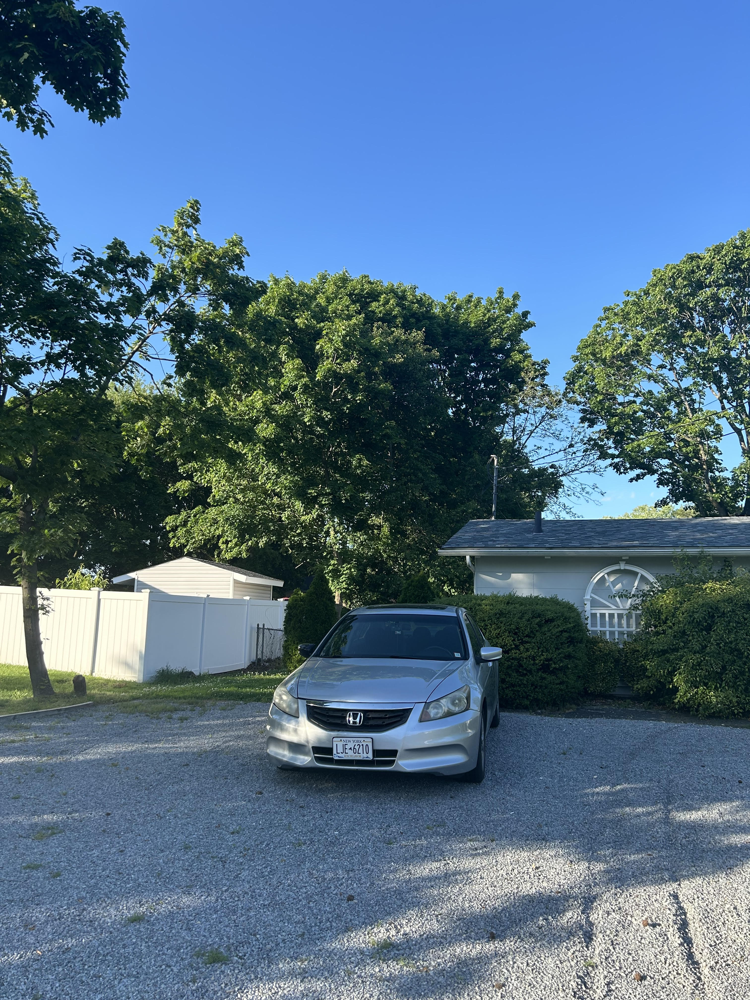


0: 384x640 1 car, 739.7ms
Speed: 4.4ms preprocess, 739.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
[1341.00146484375, 1295.338623046875, 2565.513427734375, 1689.060546875, 30.0, 0.8871073722839355, 2.0]
[1341.00146484375, 1295.338623046875, 2565.513427734375, 1689.060546875, 30.0, 0.8871073722839355]

0: 224x640 1 license_plate, 145.2ms
Speed: 3.0ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 640)


In [ ]:
results = {}

frame = cv.imread("/content/drive/MyDrive/ANPR/unnamed.jpg")
cv2_imshow(frame)
frame = cv.resize(frame, (frame_width, frame_height))
detections = coco_model.track(frame, persist=True)[0]

ret = True
frame_number = -1
vehicles = [2,3,5]


In [ ]:

for detection in detections.boxes.data.tolist():
    x1, y1, x2, y2, track_id, score, class_id = detection
    if int(class_id) in vehicles and score > 0.5:
        # print("hey")
        # print(detection)
        vehicle_bounding_boxes = []
        vehicle_bounding_boxes.append([x1, y1, x2, y2, track_id, score])
        for bbox in vehicle_bounding_boxes:
            #print(bbox)
            roi = frame[int(y1):int(y2), int(x1):int(x2)]

            # License plate detector for region of interest
            license_plates = np_model(roi)[0]

            # Process license plate
            for license_plate in license_plates.boxes.data.tolist():
                #print('so her :', license_plate)
                plate_x1, plate_y1, plate_x2, plate_y2, plate_score, _ = license_plate
                # Crop plate from region of interest
                plate = roi[int(plate_y1):int(plate_y2), int(plate_x1):int(plate_x2)]
                # De-colorize
                plate_gray = cv.cvtColor(plate, cv.COLOR_BGR2GRAY)
                # Posterize
                _, plate_threshold = cv.threshold(plate_gray, 64, 255, cv.THRESH_BINARY_INV)

                # OCR
                np_text, np_score = read_license_plate(plate_threshold)
                #print("no :",np_text)
                # If plate could be read, write results
                if np_text is not None:
                    if frame_number not in results:
                        results[frame_number] = {}
                    results[frame_number][track_id] = {
                        'car': {
                            'bbox': [x1, y1, x2, y2],
                            'bbox_score': score
                        },
                        'license_plate': {
                            'bbox': [plate_x1, plate_y1, plate_x2, plate_y2],
                            'bbox_score': plate_score,
                            'number': np_text,
                            'text_score': np_score
                        }
                    }


0: 224x640 1 license_plate, 301.9ms
Speed: 5.5ms preprocess, 301.9ms inference, 8.4ms postprocess per image at shape (1, 3, 224, 640)


In [ ]:
results

{-1: {30.0: {'car': {'bbox': [1341.00146484375,
     1295.338623046875,
     2565.513427734375,
     1689.060546875],
    'bbox_score': 0.8871073722839355},
   'license_plate': {'bbox': [335.87713623046875,
     277.89886474609375,
     601.878173828125,
     374.8998718261719],
    'bbox_score': 0.7273513078689575,
    'number': 'LJE6210',
    'text_score': 0.5688460091677744}}}}